In [34]:
import carbonbench

import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

import torch
import torch.optim as optim
from torch.utils.data import DataLoader, Subset
from torch.optim.lr_scheduler import StepLR

from sklearn.utils.class_weight import compute_class_weight

from tqdm import tqdm

In [33]:
import importlib
import carbonbench
importlib.reload(carbonbench)

<module 'carbonbench' from '/users/4/rozan012/CarbonBench/carbonbench/__init__.py'>

# Process Targets

In [2]:
# 1 Process targets
# 1.1 Load targets
targets = ['GPP_NT_VUT_USTAR50', 'RECO_NT_VUT_USTAR50', 'NEE_VUT_USTAR50']
include_qc = True
test_QC_threshold = 1 # [0,1] with 1 being the highest quality data
y = carbonbench.load_targets(targets, include_qc)
y

,date,site,lat,lon,IGBP,Koppen,Koppen_short,GPP_NT_VUT_USTAR50,RECO_NT_VUT_USTAR50,NEE_VUT_USTAR50,NEE_VUT_USTAR50_QC
0,2009-01-01,FLX_AR-SLu,-33.464800,-66.459800,MF,B,BSh,8.989840,2.957700,-6.032130,0.0
1,2009-01-02,FLX_AR-SLu,-33.464800,-66.459800,MF,B,BSh,8.912250,2.977330,-5.934920,0.0
2,2009-01-03,FLX_AR-SLu,-33.464800,-66.459800,MF,B,BSh,9.356500,3.330460,-6.026040,0.0
3,2009-01-04,FLX_AR-SLu,-33.464800,-66.459800,MF,B,BSh,9.826600,3.794460,-6.032130,0.0
4,2009-01-05,FLX_AR-SLu,-33.464800,-66.459800,MF,B,BSh,9.727970,3.793040,-5.934920,0.0
...,...,...,...,...,...,...,...,...,...,...,...
1435909,2023-12-27,JPX_JP-Tmd,42.735911,141.523147,DBF,D,Dfb,1.013866,0.617556,-0.396310,0.0
1435910,2023-12-28,JPX_JP-Tmd,42.735911,141.523147,DBF,D,Dfb,0.738017,0.734304,-0.003712,0.0
1435911,2023-12-29,JPX_JP-Tmd,42.735911,141.523147,DBF,D,Dfb,0.744890,0.765398,0.020508,0.0
1435912,2023-12-30,JPX_JP-Tmd,42.735911,141.523147,DBF,D,Dfb,0.470808,0.907578,0.436770,0.0


In [3]:
# 1.2 Explore targets
print(f"Total number of sites: {y.site.nunique()}")
print(f"Total number of samples: {len(y)}, QC∈[0,1]")
if include_qc:
    print(f"Total number of top-quality samples: {len(y[y.NEE_VUT_USTAR50_QC==1])}, QC=1")

Total number of sites: 567
Total number of samples: 1304309, QC∈[0,1]
Total number of top-quality samples: 553467, QC=1


Train sites: 453, Test sites: 114

Koppen balance:
        overall  test
Koppen               
D           284    57
C           194    39
B            55    11
A            19     4
E            15     3


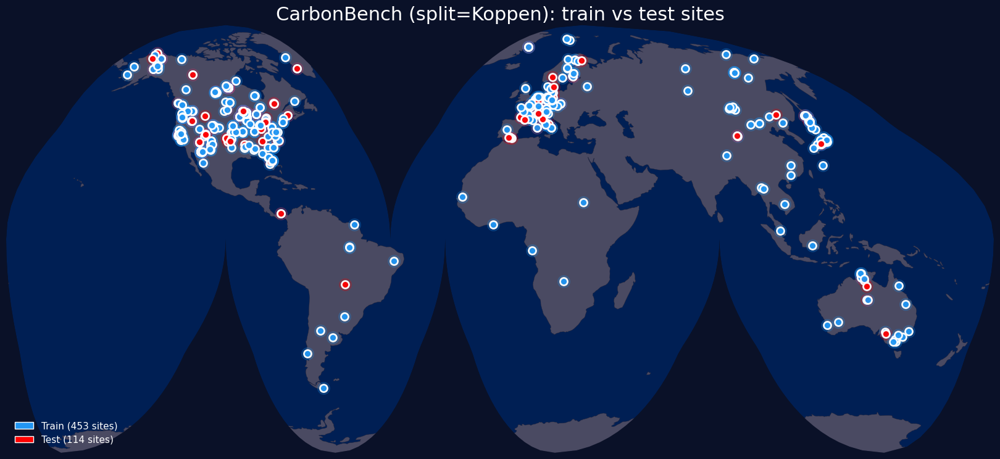

In [4]:
# 1.3 Split targets on train and test (site holdout)
task_type = 'zero-shot'# 'few-shot'
split_type = 'Koppen' # 'IGBP'
y_train, y_test = carbonbench.split_targets(y, task_type, split_type, verbose=True, plot=True)

# Process Features

In [5]:
modis = carbonbench.load_modis()

era_feature_set = 'full' # minimal (6), stanard (36), full (150)
era = carbonbench.load_era(era_feature_set)

train, val, test, x_scaler, y_scaler = carbonbench.join_features(y_train, y_test, modis, era, scale=True)

In [18]:
carbonbench.plot_feature_heatmap(train, save_path='./', figsize=(150,150)) # full figsize=(150,150), minimal figsize=(25,25)

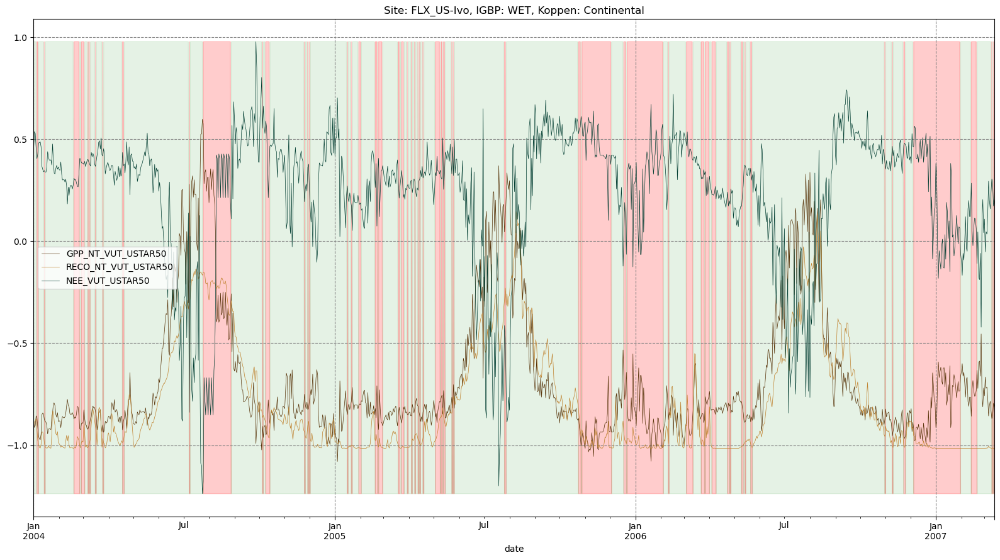

In [5]:
carbonbench.plot_site_ts(train, targets, include_qc, qc_threshold=0.75, site_name='FLX_US-Ivo', save_path=None)

In [6]:
'''Sliding Window (for time series modeling in torch)'''
batch_size = 32
window_size = 30
stride = 15
num_workers = 4 # parallelize data loading

train_hist = carbonbench.historical_cache(train, era, modis, x_scaler, window_size)
train_dataset = carbonbench.SlidingWindowDataset(train_hist, targets, include_qc, window_size=window_size, stride=stride, cat_features=['IGBP', 'Koppen', 'Koppen_short'])
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)

val_hist = carbonbench.historical_cache(val, era, modis, x_scaler, window_size)
val_dataset = carbonbench.SlidingWindowDataset(val_hist, targets, include_qc, window_size=window_size, stride=stride, encoders=train_dataset.encoders,
                                               cat_features=['IGBP', 'Koppen', 'Koppen_short'])
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)

In [10]:
'''Tabular Processing (RF, XGBoost, etc.)'''
X_train_tab, y_train_tab, y_train_qc_tab = carbonbench.tabular(train, targets, include_qc, cat_features=['IGBP', 'Koppen', 'Koppen_short'])
X_val_tab, y_val_tab, y_val_qc_tab = carbonbench.tabular(val, targets, include_qc, cat_features=['IGBP', 'Koppen', 'Koppen_short'])
X_test_tab, y_test_tab, y_test_qc_tab = carbonbench.tabular(test, targets, include_qc, test_QC_threshold, cat_features=['IGBP', 'Koppen', 'Koppen_short'])

# TODO:
- [x] Add koppen short
- [x] Sliding window pipeline
    - [x] One-hot for Koppen and IGBP
- [x] Process tabular
- [x] LSTM baseline
- [x] Evaluation tools and metrics
- [ ] Results visuals

# Baselines

In [36]:
results = {}

## Tree Models

In [11]:
import xgboost as xgb

In [12]:
dtrain = xgb.DMatrix(X_train_tab.drop('site', axis=1), label=y_train_tab, weight=y_train_qc_tab.clip(1e-2, 1), enable_categorical=True)
dval = xgb.DMatrix(X_val_tab.drop('site', axis=1), label=y_val_tab, enable_categorical=True)

params = {
    'colsample_bynode': 1,
    'learning_rate': 0.05,
    'max_depth': 10,
    'num_parallel_tree': 1,
    'objective': 'reg:squarederror',
    'tree_method': 'hist',
    'min_child_weight': 5
}

model = xgb.train(
    params=params,
    dtrain=dtrain,
    num_boost_round=1000,
    early_stopping_rounds=10,
    evals=[(dval, 'validation')],
    verbose_eval=50,
)

[0]	validation-rmse:0.99868
[50]	validation-rmse:0.59967
[100]	validation-rmse:0.58027
[150]	validation-rmse:0.57538
[200]	validation-rmse:0.57305
[250]	validation-rmse:0.57145
[300]	validation-rmse:0.57048
[350]	validation-rmse:0.56944
[400]	validation-rmse:0.56884
[450]	validation-rmse:0.56826
[500]	validation-rmse:0.56788
[550]	validation-rmse:0.56757
[600]	validation-rmse:0.56718
[650]	validation-rmse:0.56699
[700]	validation-rmse:0.56685
[706]	validation-rmse:0.56684


In [13]:
results['XGBoost'] = carbonbench.eval_tree_model(X_test_tab, y_test_tab, targets, model, y_scaler, method='xgb')

			R2	RMSE	MAPE
GPP_NT_VUT_USTAR50:	0.41	2.24	1.25
RECO_NT_VUT_USTAR50:	0.34	1.69	1.15
NEE_VUT_USTAR50:	0.29	1.55	7.93


# PyTorch

In [7]:
'''Compute Upsampling Weights for the Custom Loss Function'''
IGBP = train['IGBP'].values
IGBP_weights = compute_class_weight(class_weight="balanced", classes=np.unique(IGBP), y=IGBP)
IGBP_weights = {str(k): float(IGBP_weights[i]) for i,k in enumerate(np.unique(IGBP))}

Koppen = train['Koppen'].values
Koppen_weights = compute_class_weight(class_weight="balanced", classes=np.unique(Koppen), y=Koppen)
Koppen_weights = {str(k): float(Koppen_weights[i]) for i,k in enumerate(np.unique(Koppen))}

In [8]:
test_hist = carbonbench.historical_cache(test, era, modis, x_scaler, window_size)
test_dataset = carbonbench.SlidingWindowDataset(test_hist, targets, include_qc, window_size=window_size, QC_threshold=test_QC_threshold, stride=1, cat_features=['IGBP', 'Koppen', 'Koppen_short'],
                                    encoders=train_dataset.encoders)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers, drop_last=False)

## Train one model

In [23]:
input_dynamic_channels = 164 # 12 - MODIS + lat + lon + ERA (6/36/150)
input_static_channels = sum(len(train_dataset.encoders[k].categories_[0]) for k in ("IGBP", "Koppen", "Koppen_short"))
hidden_dim = 64
output_channels = len(targets)
dropout = 0.2
nhead = 4
layers = 1
tf_layers = 4
patch_len = 10
patch_stride = 5
num_epoch = 25
device = 'cuda'

In [14]:
import importlib
import carbonbench
importlib.reload(carbonbench)

import carbonbench

In [24]:
#model = carbonbench.ctlstm(input_dynamic_channels, input_static_channels, hidden_dim, output_channels, dropout, layers).to(device)
model = carbonbench.patch_transformer(input_dynamic_channels, input_static_channels, output_channels,
        window_size, stride, patch_len, patch_stride, hidden_dim, nhead, tf_layers, dropout).to(device)
#model = carbonbench.transformer(input_dynamic_channels, input_static_channels, output_channels, window_size, hidden_dim, nhead, tf_layers, dropout).to(device)
architecture = model.__class__.__name__

In [37]:
criterion = carbonbench.CustomLoss(IGBP_weights, Koppen_weights) #torch.nn.MSELoss() 
optimizer = optim.Adam(model.parameters(), lr=1e-3) 
scheduler = StepLR(optimizer, step_size=10, gamma=0.5)

In [38]:
best = np.inf
for epoch in tqdm(range(num_epoch)):
    model.train()
    for x, x_static, y, qc, igbp_w, koppen_w in train_loader:
        x, x_static, y, qc, igbp_w, koppen_w = x.to(device), x_static.to(device), y.to(device), qc.to(device), igbp_w.to(device), koppen_w.to(device)
        optimizer.zero_grad()
        if architecture in ['lstm', 'gru']:
            pred = model(x)
        else:
            pred = model(x, x_static)
            
        if criterion.__class__.__name__=='CustomLoss':
            error = criterion(pred[:,-stride:, :], y[:,-stride:,:3], qc, igbp_w, koppen_w)
        else:
            error = criterion(pred[:,-stride:, :], y[:,-stride:,:3])
            
        error.backward()
        optimizer.step()
    scheduler.step()
    
    if epoch % 5 == 0:
        model.eval()
        val_preds = []
        val_true = []
        with torch.no_grad():
            for x, x_static, y, _, _, _ in val_loader:
                x, x_static, y = x.to(device), x_static.to(device), y.squeeze().to(device)
                if architecture in ['lstm', 'gru']:
                    preds = model(x)
                else:
                    preds = model(x, x_static)
                val_preds.append(preds.detach().cpu())
                val_true.append(y.detach().cpu())
        val_preds = torch.cat(val_preds).squeeze()
        val_true = torch.cat(val_true).squeeze()
        
        test_loss = criterion(val_preds.to(device)[:,-stride:,:], val_true[:,-stride:, :3].to(device))

        best_old = best
        best = min(test_loss, best)
#         if abs(best) < best_old:
#             torch.save(model.state_dict(), f'{model_folder}/model_state.pth')
        print(f'Validation RMSE: {test_loss:0.3f}')

  4%|█▊                                          | 1/25 [00:48<19:13, 48.08s/it]

Validation RMSE: 0.518


 24%|██████████▌                                 | 6/25 [04:14<13:37, 43.02s/it]

Validation RMSE: 0.491


 44%|██████████████████▉                        | 11/25 [07:50<10:17, 44.08s/it]

Validation RMSE: 0.466


 64%|███████████████████████████▌               | 16/25 [11:17<06:27, 43.04s/it]

Validation RMSE: 0.458


 84%|████████████████████████████████████       | 21/25 [14:44<02:51, 42.79s/it]

Validation RMSE: 0.459


100%|███████████████████████████████████████████| 25/25 [17:22<00:00, 41.71s/it]


In [39]:
results[architecture] = carbonbench.eval_nn_model(test_dataset, test, targets, model, architecture, device, y_scaler, window_size)architecture

			R2	RMSE	MAPE
GPP_NT_VUT_USTAR50:	0.44	2.12	0.7
RECO_NT_VUT_USTAR50:	0.38	1.51	0.5
NEE_VUT_USTAR50:	0.19	1.73	5.98


# Train Many Models

In [21]:
input_dynamic_channels = 164 # 12 - MODIS + lat + lon + ERA (6/36/150)
input_static_channels = 39
hidden_dim = 128
output_channels = len(targets)
dropout = 0.2
nhead = 4
layers = 1
tf_layers = 4
num_epoch = 25
device = 'cuda'

base_args = {
    'input_dynamic_channels': input_dynamic_channels,
    'hidden_dim': hidden_dim,
    'output_channels': output_channels,
    'dropout': dropout,
}

In [31]:
for model_class in [carbonbench.lstm, carbonbench.ctlstm, carbonbench.gru,  carbonbench.ctgru, carbonbench.transformer, carbonbench.patch_transformer]: 
    architecture = model_class.__name__
    
    kwargs = base_args.copy()
    if architecture in ['lstm', 'gru']:
        kwargs['layers'] = layers
    else:
        kwargs['input_static_channels'] = input_static_channels
        
    if 'transformer' in architecture:
        kwargs['nhead'] = nhead
        kwargs['num_layers'] = tf_layers
        kwargs['seq_len'] = window_size
        if 'patch' in architecture:
            kwargs['pred_len'] = stride
            kwargs['patch_len'] = patch_len
            kwargs['stride'] = patch_stride
    else:
        kwargs['layers'] = layers
        
    model = model_class(**kwargs).to(device)
    criterion = carbonbench.CustomLoss(IGBP_weights, Koppen_weights)#torch.nn.MSELoss()
    optimizer = optim.AdamW(model.parameters(), lr=1e-3) 
    scheduler = StepLR(optimizer, step_size=10, gamma=0.5)
    
    best = np.inf
    for epoch in tqdm(range(num_epoch)):
        model.train()
        for x, x_static, y, qc, igbp_w, koppen_w in train_loader:
            x, x_static, y, qc, igbp_w, koppen_w = x.to(device), x_static.to(device), y.to(device), qc.to(device), igbp_w.to(device), koppen_w.to(device)
            optimizer.zero_grad()
            if architecture in ['lstm', 'gru']:
                pred = model(x)
            else:
                pred = model(x, x_static)

            if criterion.__class__.__name__=='CustomLoss':
                error = criterion(pred[:,-stride:, :], y[:,-stride:,:3], qc, igbp_w, koppen_w)
            else:
                error = criterion(pred[:,-stride:, :], y[:,-stride:,:3])

            error.backward()
            optimizer.step()
        scheduler.step()

        if epoch % 5 == 0:
            model.eval()
            val_preds = []
            val_true = []
            with torch.no_grad():
                for x, x_static, y, _, _, _ in val_loader:
                    x, x_static, y = x.to(device), x_static.to(device), y.squeeze().to(device)
                    if architecture in ['lstm', 'gru']:
                        preds = model(x)
                    else:
                        preds = model(x, x_static)
                    val_preds.append(preds.detach().cpu())
                    val_true.append(y.detach().cpu())
            val_preds = torch.cat(val_preds).squeeze()
            val_true = torch.cat(val_true).squeeze()

            test_loss = criterion(val_preds.to(device)[:,-stride:,:], val_true[:,-stride:, :3].to(device))

            best_old = best
            best = min(test_loss, best)
            if abs(best) < best_old:
                best_model = model.state_dict()
                #torch.save(model.state_dict(), f'{model_folder}/model_state.pth')
            print(f'Validation RMSE: {test_loss:0.3f}')
    print("="*10, f"{architecture} Summary", "="*10)
    model.load_state_dict(best_model) # load best model
    results[architecture] = carbonbench.eval_nn_model(test_dataset, test, targets, model, architecture, device, y_scaler, window_size)

  4%|█▊                                          | 1/25 [00:44<17:46, 44.44s/it]

Validation RMSE: 0.556


 24%|██████████▌                                 | 6/25 [04:06<13:06, 41.39s/it]

Validation RMSE: 0.513


 44%|██████████████████▉                        | 11/25 [07:29<09:39, 41.40s/it]

Validation RMSE: 0.438


 64%|███████████████████████████▌               | 16/25 [10:53<06:13, 41.48s/it]

Validation RMSE: 0.449


 84%|████████████████████████████████████       | 21/25 [14:15<02:44, 41.15s/it]

Validation RMSE: 0.417


100%|███████████████████████████████████████████| 25/25 [16:52<00:00, 40.50s/it]


========== lstm Summary ==========
			R2	RMSE	MAPE
GPP_NT_VUT_USTAR50:	0.46	2.08	0.89
RECO_NT_VUT_USTAR50:	0.37	1.49	0.68
NEE_VUT_USTAR50:	0.23	1.67	6.12


  4%|█▊                                          | 1/25 [00:44<17:59, 44.98s/it]

Validation RMSE: 0.478


 24%|██████████▌                                 | 6/25 [04:10<13:19, 42.08s/it]

Validation RMSE: 0.411


 44%|██████████████████▉                        | 11/25 [07:36<09:46, 41.88s/it]

Validation RMSE: 0.384


 64%|███████████████████████████▌               | 16/25 [11:02<06:16, 41.86s/it]

Validation RMSE: 0.385


 84%|████████████████████████████████████       | 21/25 [14:27<02:47, 41.90s/it]

Validation RMSE: 0.381


100%|███████████████████████████████████████████| 25/25 [17:08<00:00, 41.13s/it]


========== ctlstm Summary ==========
			R2	RMSE	MAPE
GPP_NT_VUT_USTAR50:	0.47	2.06	0.8
RECO_NT_VUT_USTAR50:	0.37	1.5	0.68
NEE_VUT_USTAR50:	0.28	1.62	5.98


  4%|█▊                                          | 1/25 [00:44<17:57, 44.90s/it]

Validation RMSE: 0.535


 24%|██████████▌                                 | 6/25 [04:08<13:12, 41.71s/it]

Validation RMSE: 0.471


 44%|██████████████████▉                        | 11/25 [07:32<09:41, 41.57s/it]

Validation RMSE: 0.437


 64%|███████████████████████████▌               | 16/25 [10:56<06:14, 41.56s/it]

Validation RMSE: 0.436


 84%|████████████████████████████████████       | 21/25 [14:20<02:46, 41.56s/it]

Validation RMSE: 0.429


100%|███████████████████████████████████████████| 25/25 [17:00<00:00, 40.81s/it]


========== gru Summary ==========
			R2	RMSE	MAPE
GPP_NT_VUT_USTAR50:	0.45	2.13	0.91
RECO_NT_VUT_USTAR50:	0.35	1.55	0.69
NEE_VUT_USTAR50:	0.22	1.71	6.57


  4%|█▊                                          | 1/25 [00:44<17:51, 44.64s/it]

Validation RMSE: 0.505


 24%|██████████▌                                 | 6/25 [04:08<13:11, 41.67s/it]

Validation RMSE: 0.411


 44%|██████████████████▉                        | 11/25 [07:31<09:40, 41.46s/it]

Validation RMSE: 0.396


 64%|███████████████████████████▌               | 16/25 [10:55<06:13, 41.46s/it]

Validation RMSE: 0.384


 84%|████████████████████████████████████       | 21/25 [14:18<02:45, 41.42s/it]

Validation RMSE: 0.389


100%|███████████████████████████████████████████| 25/25 [16:57<00:00, 40.69s/it]


========== ctgru Summary ==========
			R2	RMSE	MAPE
GPP_NT_VUT_USTAR50:	0.48	2.04	0.8
RECO_NT_VUT_USTAR50:	0.38	1.48	0.68
NEE_VUT_USTAR50:	0.24	1.65	6.61


  4%|█▊                                          | 1/25 [00:51<20:29, 51.21s/it]

Validation RMSE: 0.712


 24%|██████████▌                                 | 6/25 [04:46<15:13, 48.08s/it]

Validation RMSE: 0.809


 44%|██████████████████▉                        | 11/25 [08:42<11:11, 47.98s/it]

Validation RMSE: 0.800


 64%|███████████████████████████▌               | 16/25 [12:37<07:10, 47.87s/it]

Validation RMSE: 0.794


 84%|████████████████████████████████████       | 21/25 [16:33<03:11, 47.85s/it]

Validation RMSE: 0.698


100%|███████████████████████████████████████████| 25/25 [19:37<00:00, 47.10s/it]


========== transformer Summary ==========
			R2	RMSE	MAPE
GPP_NT_VUT_USTAR50:	0.28	2.51	0.95
RECO_NT_VUT_USTAR50:	0.26	1.65	0.68
NEE_VUT_USTAR50:	0.07	1.91	7.24


# Eval All Models by site, IGBP, and Koppen

In [28]:
metrics = ['RMSE', 'R2', 'MAPE']

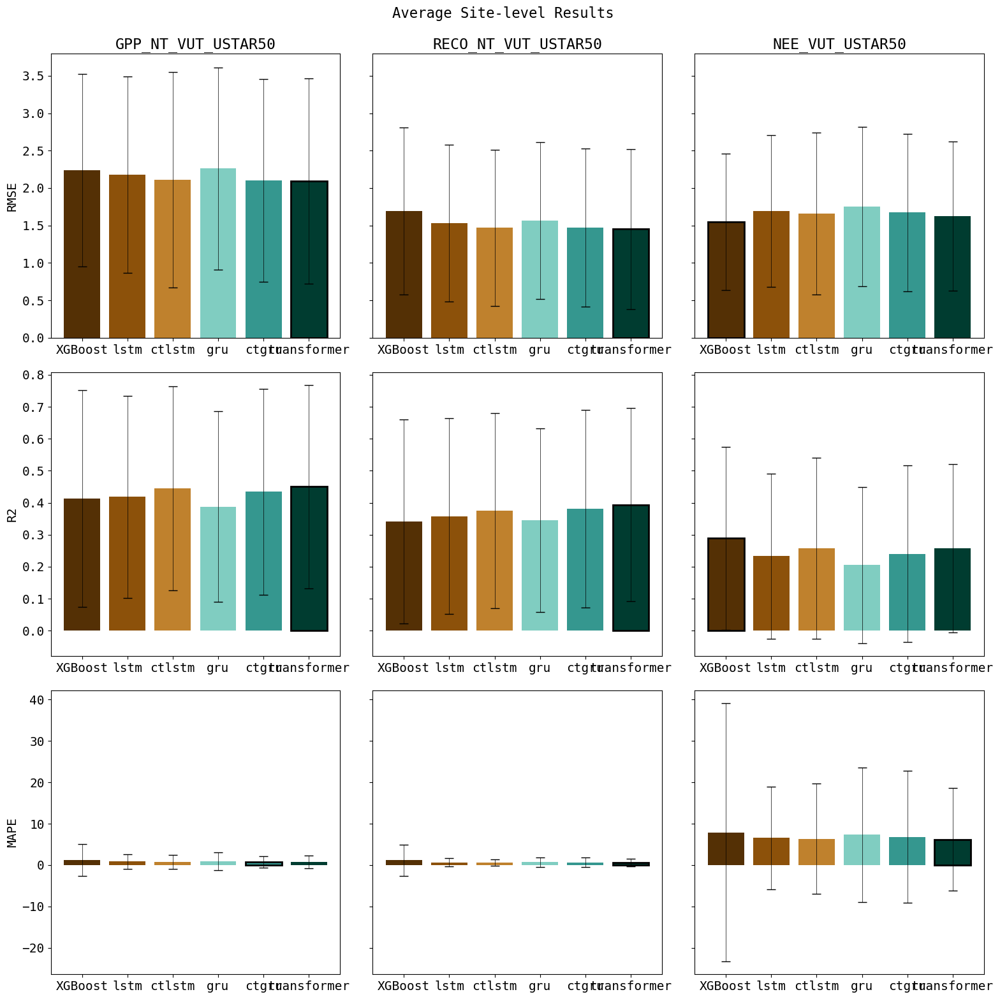

In [29]:
carbonbench.plot_bars(results, metrics, targets)

In [45]:
for target in targets:
    print("="*20, target, '='*20)
    for model in results.keys():
        res = round(results[model][target][metrics].mean().T,3)
        if len(model)<8:
            print(f"Model: {model}\t\tRMSE={res.RMSE.item()}\tR2={res.R2.item()}\tMAPE={res.MAPE.item()}")
        else:
            print(f"Model: {model}\tRMSE={res.RMSE.item()}\tR2={res.R2.item()}\tMAPE={res.MAPE.item()}")

==================== GPP_NT_VUT_USTAR50 ====================
Model: XGBoost		RMSE=2.24	R2=0.413	MAPE=1.247
Model: lstm		RMSE=2.178	R2=0.419	MAPE=0.896
Model: ctlstm		RMSE=2.11	R2=0.445	MAPE=0.808
Model: gru		RMSE=2.263	R2=0.388	MAPE=0.976
Model: ctgru		RMSE=2.101	R2=0.435	MAPE=0.789
Model: transformer	RMSE=2.093	R2=0.451	MAPE=0.802
==================== RECO_NT_VUT_USTAR50 ====================
Model: XGBoost		RMSE=1.692	R2=0.341	MAPE=1.154
Model: lstm		RMSE=1.533	R2=0.358	MAPE=0.691
Model: ctlstm		RMSE=1.47	R2=0.375	MAPE=0.629
Model: gru		RMSE=1.566	R2=0.345	MAPE=0.724
Model: ctgru		RMSE=1.471	R2=0.381	MAPE=0.67
Model: transformer	RMSE=1.453	R2=0.394	MAPE=0.619
==================== NEE_VUT_USTAR50 ====================
Model: XGBoost		RMSE=1.55	R2=0.289	MAPE=7.929
Model: lstm		RMSE=1.69	R2=0.234	MAPE=6.57
Model: ctlstm		RMSE=1.659	R2=0.257	MAPE=6.37
Model: gru		RMSE=1.752	R2=0.205	MAPE=7.321
Model: ctgru		RMSE=1.673	R2=0.241	MAPE=6.831
Model: transformer	RMSE=1.626	R2=0.258	MAPE=6.207


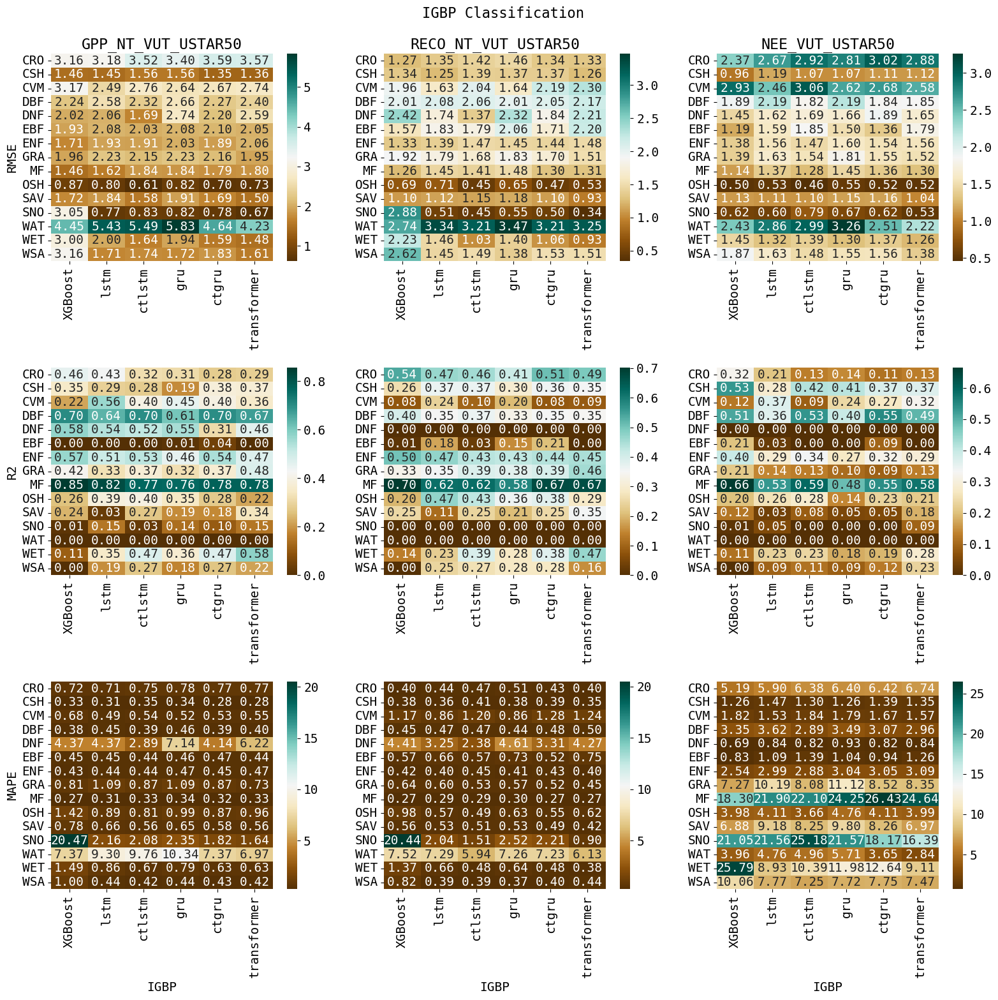

In [30]:
carbonbench.plot_heatmap(results, metrics, targets, classification='IGBP')

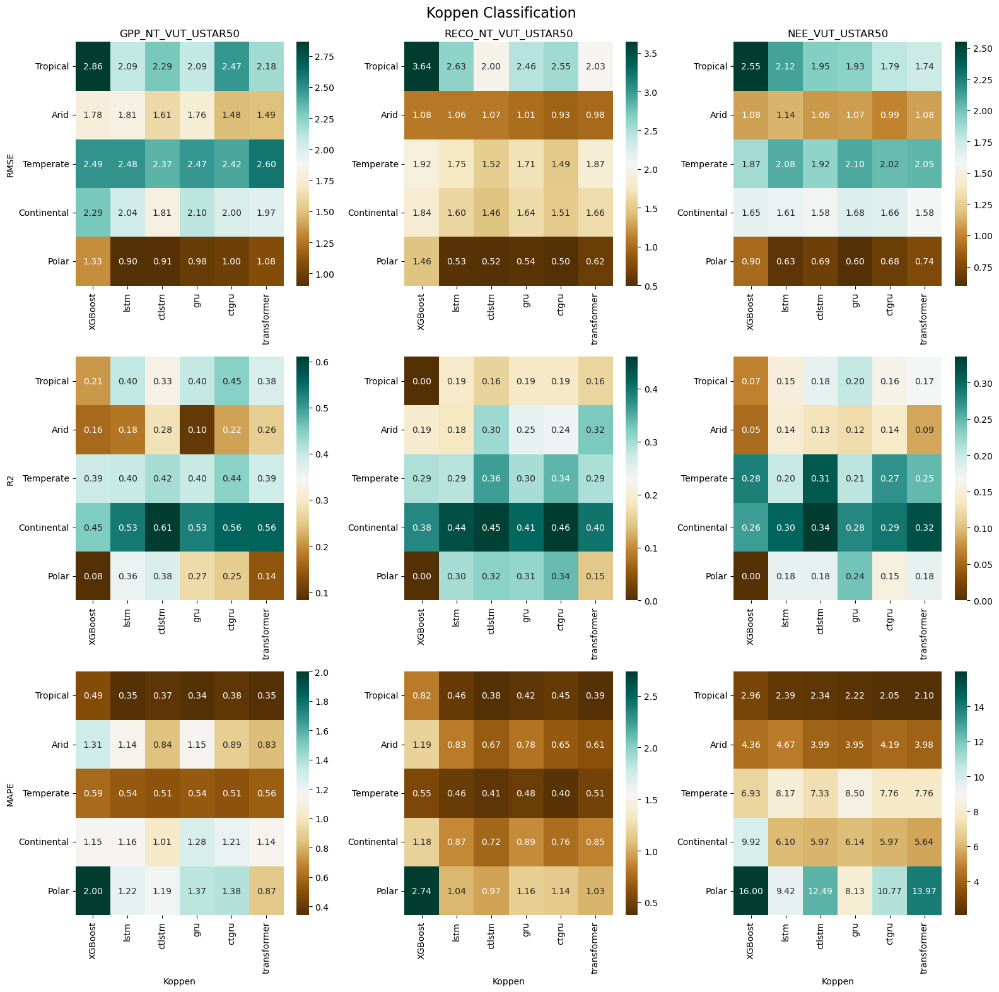

In [54]:
carbonbench.plot_heatmap(results, metrics, targets, classification='Koppen')